# Biophysics

The biophysics of a cell has a massive influence in how it integrates synaptic input. In the [previous notebook](./01_current_injection.ipynb\), we ran some current injections on a cell with predefined biophysical parameters. This notebook will provide a walkthrough on how to interact with the biophysical details of a cell.

In [1]:
%matplotlib inline
import Interface as I
from getting_started import getting_started_dir
db_path = I.os.path.join(getting_started_dir, 'example_simulation_data', 'biophysics')
db = I.DataBase(db_path)

trying to connect to distributed locking server {'config': {'hosts': 'somalogin02-hs:33333'}, 'type': 'zookeeper'}
success!
[INFO] ISF: Current version: heads/publish
[INFO] ISF: Current pid: 31441
[INFO] mechanisms: Loading mechanisms:


--No graphics will be displayed.





[INFO] ISF: Loaded modules with __version__ attribute are:
IPython: 8.12.3, Interface: heads/publish, PIL: 8.2.0, _csv: 1.0, _ctypes: 1.1.0, _curses: b'2.2', _decimal: 1.70, argparse: 1.1, attr: 20.3.0, backcall: 0.2.0, blake3: 0.3.3, blosc: 1.10.2, bluepyopt: 1.9.126, bottleneck: 1.3.2, cffi: 1.14.3, click: 7.1.2, cloudpickle: 1.6.0, colorama: 0.4.4, comm: 0.2.1, csv: 1.0, ctypes: 1.1.0, cycler: 0.10.0, cytoolz: 0.11.0, dash: 2.9.3, dask: 2.30.0, dateutil: 2.8.2, deap: 1.3, debugpy: 1.8.0, decimal: 1.70, decorator: 4.4.2, distributed: 2.30.1, distutils: 3.8.5, executing: 2.0.1, filelock: 3.0.12, flask: 1.1.2, flask_cors: 4.0.0, frozendict: 2.3.8, fsspec: 0.8.3, future: 0.18.2, gevent: 20.9.0, greenlet: 0.4.17, ipaddress: 1.0, ipykernel: 6.29.0, ipython_genutils: 0.2.0, ipywidgets: 7.5.1, itsdangerous: 1.1.0, jedi: 0.17.1, jinja2: 3.0.3, joblib: 1.3.2, json: 2.0.9, jupyter_client: 8.6.0, jupyter_core: 5.7.1, kazoo: 2.8.0, kiwisolver: 1.3.0, llvmlite: 0.34.0, logging: 0.5.1.2, markup

In [2]:
# init
objectives_2BAC = [
       '1BAC_APheight', '1BAC_ISI', '1BAC_ahpdepth', '1BAC_caSpike_height', 
       '1BAC_caSpike_width', '1BAC_spikecount', '2BAC_APheight', '2BAC_ISI', 
       '2BAC_ahpdepth', '2BAC_caSpike_height', '2BAC_caSpike_width', '2BAC_spikecount',
        'bAP_APheight', 'bAP_APwidth', 'bAP_att2', 'bAP_att3', 'bAP_spikecount']
params_py2 = [
       'ephys.CaDynamics_E2.apic.decay',
       'ephys.CaDynamics_E2.apic.gamma', 'ephys.CaDynamics_E2.axon.decay',
       'ephys.CaDynamics_E2.axon.gamma', 'ephys.CaDynamics_E2.soma.decay',
       'ephys.CaDynamics_E2.soma.gamma', 'ephys.Ca_HVA.apic.gCa_HVAbar',
       'ephys.Ca_HVA.axon.gCa_HVAbar', 'ephys.Ca_HVA.soma.gCa_HVAbar',
       'ephys.Ca_LVAst.apic.gCa_LVAstbar', 'ephys.Ca_LVAst.axon.gCa_LVAstbar',
       'ephys.Ca_LVAst.soma.gCa_LVAstbar', 'ephys.Im.apic.gImbar',
       'ephys.K_Pst.axon.gK_Pstbar', 'ephys.K_Pst.soma.gK_Pstbar',
       'ephys.K_Tst.axon.gK_Tstbar', 'ephys.K_Tst.soma.gK_Tstbar',
       'ephys.NaTa_t.apic.gNaTa_tbar', 'ephys.NaTa_t.axon.gNaTa_tbar',
       'ephys.NaTa_t.soma.gNaTa_tbar', 'ephys.Nap_Et2.axon.gNap_Et2bar',
       'ephys.Nap_Et2.soma.gNap_Et2bar', 'ephys.SK_E2.apic.gSK_E2bar',
       'ephys.SK_E2.axon.gSK_E2bar', 'ephys.SK_E2.soma.gSK_E2bar',
       'ephys.SKv3_1.apic.gSKv3_1bar', 'ephys.SKv3_1.apic.offset',
       'ephys.SKv3_1.apic.slope', 'ephys.SKv3_1.axon.gSKv3_1bar',
       'ephys.SKv3_1.soma.gSKv3_1bar', 'ephys.none.apic.g_pas',
       'ephys.none.axon.g_pas', 'ephys.none.dend.g_pas',
       'ephys.none.soma.g_pas', 'scale_apical.scale']
params_py3 = [
       p.replace('ephys.CaDynamics_E2', 'ephys.CaDynamics_E2_v2') for p in params_py2]

We will use two important objects throughout this notebook: a [Simulator](../biophysics_fitting/simulator.py) and [Evaluator](../biophysics_fitting/evaluator.py). These provide high-level access to perform and evaluate current injection experiments for varying biophysical parameters.

To fully appreciate the convenience of these objects, we will first use them to simply fetch some vector of biophysical parameters and use these for low-level simulations using [single cell parser](../single_cell_parser/__init__.py)

In [3]:
morphology = '89'

def get_simulator(db, id_):
    s = db[id_]['get_Simulator'](db[id_])
    return s

def get_evaluator(db, id_):
    e = db[id_]['get_Evaluator'](db[id_])
    return e

def get_fixed_params(db, id_):
    fp = db[id_]['get_fixed_params'](db[id_])
    return fp

In [4]:
# get simulator and evaluator object for a specific morphology
s = get_simulator(db, morphology)
e = get_evaluator(db, morphology)

trying to connect to distributed locking server {'config': {'hosts': 'somalogin02-hs:33333'}, 'type': 'zookeeper'}
success!


## Low-level access to cell biophysics

Let's inspect what these biophysical parameters look like

In [5]:
# get the biophysical parameters of one examplary biophysical model
p = db['example_models'].iloc[0][params_py3]
p

ephys.CaDynamics_E2_v2.apic.decay        59.0477
ephys.CaDynamics_E2_v2.apic.gamma     0.00112918
ephys.CaDynamics_E2_v2.axon.decay        743.739
ephys.CaDynamics_E2_v2.axon.gamma     0.00121861
ephys.CaDynamics_E2_v2.soma.decay        159.292
ephys.CaDynamics_E2_v2.soma.gamma      0.0137903
ephys.Ca_HVA.apic.gCa_HVAbar          0.00376466
ephys.Ca_HVA.axon.gCa_HVAbar         0.000280338
ephys.Ca_HVA.soma.gCa_HVAbar         4.83005e-05
ephys.Ca_LVAst.apic.gCa_LVAstbar        0.194205
ephys.Ca_LVAst.axon.gCa_LVAstbar      0.00674865
ephys.Ca_LVAst.soma.gCa_LVAstbar     5.23378e-06
ephys.Im.apic.gImbar                 0.000758139
ephys.K_Pst.axon.gK_Pstbar              0.367934
ephys.K_Pst.soma.gK_Pstbar            0.00192893
ephys.K_Tst.axon.gK_Tstbar             0.0185365
ephys.K_Tst.soma.gK_Tstbar             0.0831176
ephys.NaTa_t.apic.gNaTa_tbar           0.0185236
ephys.NaTa_t.axon.gNaTa_tbar             3.66734
ephys.NaTa_t.soma.gNaTa_tbar              1.7436
ephys.Nap_Et2.axon.g

We have 35 biophysical parameters, relating to varying biophysical aspects for the soma, axon (AIS), apical dendrite, and other dendrites (taken to be passive for current injection experiments).

|Name|Meaning|Unit|
|---|---|---|
|ephys.X.\<location\>.gXbar| Density of Hodgkin Huxley-type channel X |[$S/cm^2$]|
|scale_apical.scale|Scaling factor for the diameter of the apical dendrite|None|
|ephys.CaDynamics_E2_v2.\<location\>.gamma| Ratio of free $Ca^{2+}$ | None|
|ephys.CaDynamics_E2_v2.\<location\>.gamma | Time constant of first-order dynamic $Ca^{2+}$-buffering| [$ms$]|
|ephys.SKv3_1.apic.offset/slope|Distribution parameters of $SKv3.1$ channels|[$\mu m$]/None|

Convert the biophysical parameters to a dictionary and use this for simulation

In [6]:
neup = s.setup.get_cell_params_with_default_sim_prams(p)

In [7]:
cell = I.scp.create_cell(neup.neuron)

In [8]:
neup.sim

{'tStart': 0.0,
 'tStop': 295,
 'dt': 0.025,
 'Vinit': -75.0,
 'T': 34.0,
 'recordingSites': []}

Initialize the cell with these channels and let it converge to its resting state

In [9]:
sim_params = I.scp.NTParameterSet({'tStart': 0.0,'tStop': 295+55,'dt': 0.025,'Vinit': -75.0,'T': 34.0,'recordingSites': []})
I.scp.init_neuron_run(sim_params, vardt = True)

In [10]:
t = I.np.array(cell.tVec) # time
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

In [11]:
I.plt.plot(t,v)

The cell has reached a steady-state at around 250 ms. Let's inject a step current at the soma that's strong enough to evoke a backpropagating action potential (i.e. a $bAP$ stimulus)

In [12]:
from neuron import h
iclamp = h.IClamp(0.5, sec=cell.soma)
iclamp.delay = 295 # give the cell time to reach steady state
iclamp.dur = 5 # [ms]
iclamp.amp = 1.9 # [nA]

In [13]:
sim_params = I.scp.NTParameterSet({
    'tStart': 0.0,'tStop': 295+55,'dt': 0.025,'Vinit': -75.0,'T': 34.0,'recordingSites': []})
I.scp.init_neuron_run(sim_params, vardt = True)

In [14]:
t = I.np.array(cell.tVec) # time
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

In [15]:
I.plt.plot(t,v)

Let's add a well-timed additional epsp-shaped current injection in the apical dendrite, i.e. a $BAC$-stimulus ($bAP$-activated $Ca^{2+}$-spike).

In [16]:
### let's add the dendritic current injection
from biophysics_fitting.setup_stim import setup_apical_epsp_injection

In [17]:
# Where exactly do we inject the epsp? We already saved this information:
# Morphology "89" has a rather deep bifurcation
# epsp injection at 294um from the soma.
get_fixed_params(db, '89')['BAC.stim.dist']

294.8203371921156

In [18]:
setup_apical_epsp_injection(
    cell, 
    dist = get_fixed_params(db, '89')['BAC.stim.dist'],
    amplitude=0.5,  # [nA]
    delay=300,  # [ms]
    rise=1.0,  # [ms]
    decay=5  # [ms]
    )

In [19]:
I.scp.init_neuron_run(sim_params, vardt = True)

In [20]:
t = I.np.array(cell.tVec) # time

In [21]:
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

In [22]:
# no stimulus set up, steady state reached at around 200 ms
I.plt.plot(t,v)

## High-level access

Now, let's see how convenient the `Simulator` and `Evaluator` objects are.
Given a Simulator `s` and a vector of biophysical parameters `p`, getting the simulated cell is as easy as:

In [23]:
cell, _ = s.get_simulated_cell(p, 'BAC')

That's it.

parallelMovieMaker
files are here: animation/animation_oh7k7uee/*.png



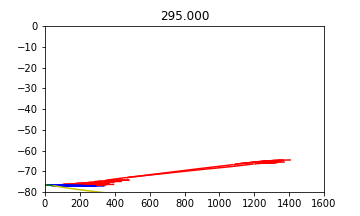
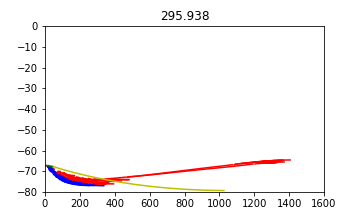
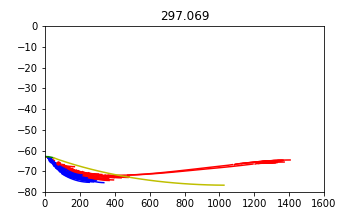
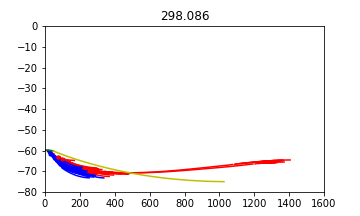
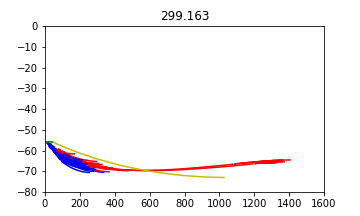
...
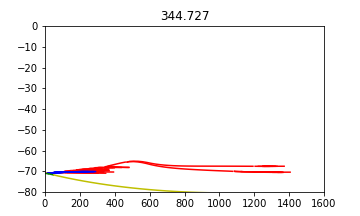
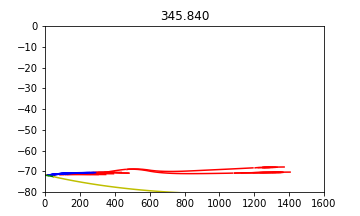
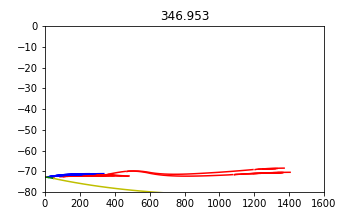
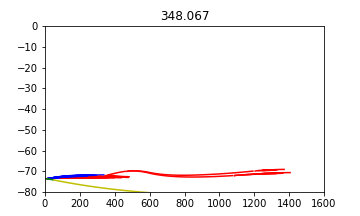
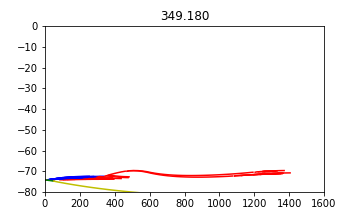

In [24]:
I.cell_to_ipython_animation(cell, tstart = 295, tend = 350, embedded = True)


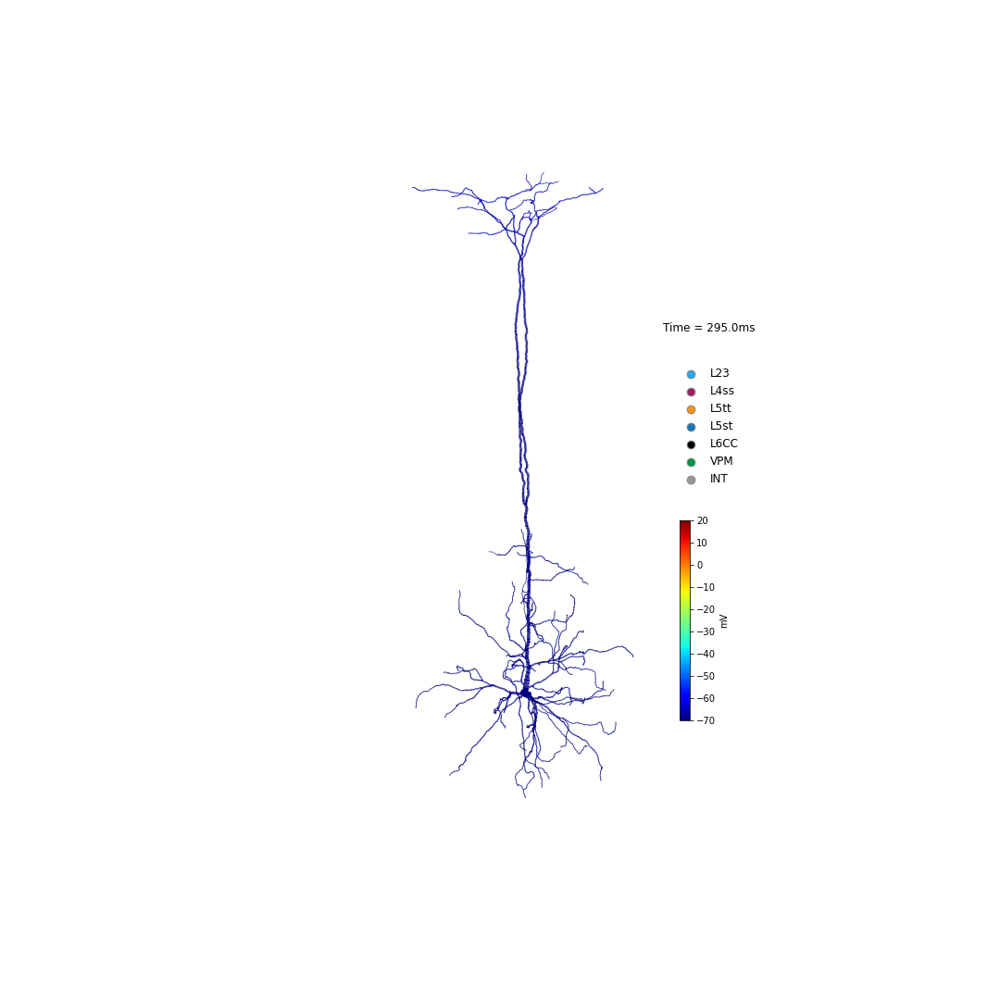
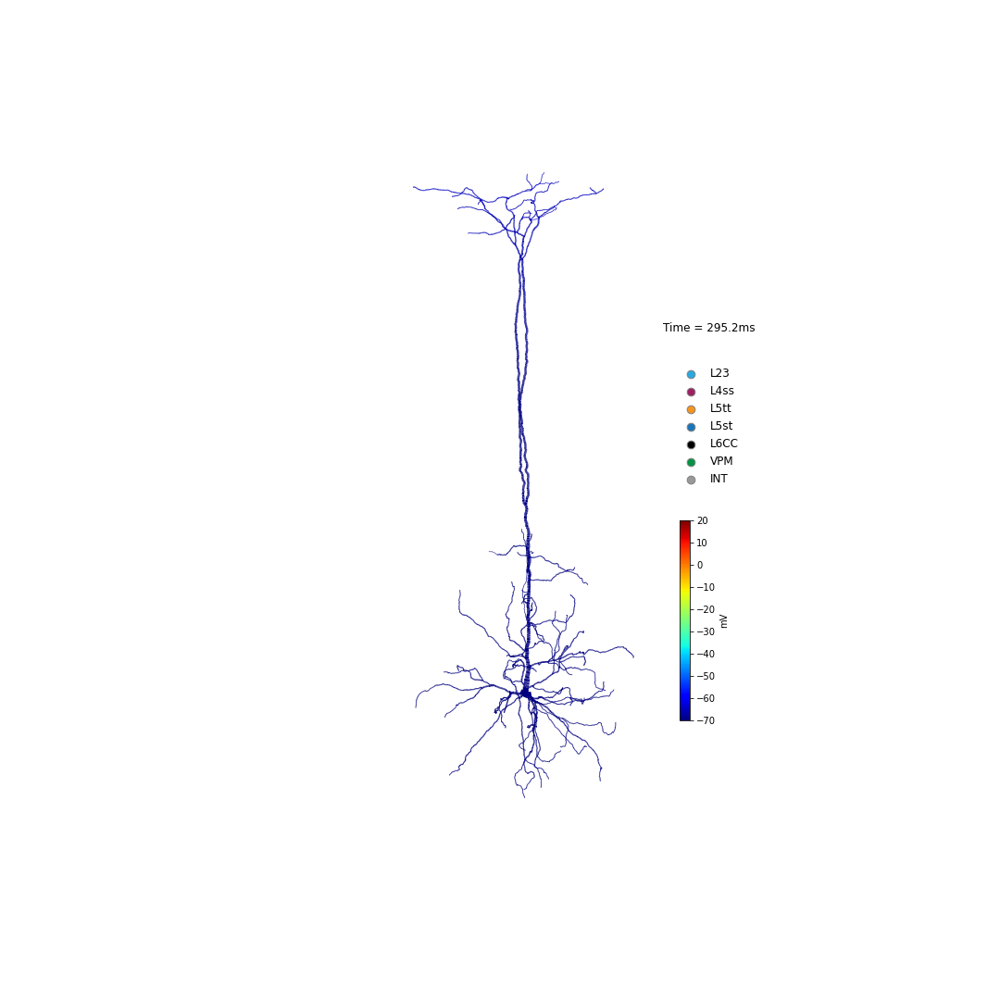
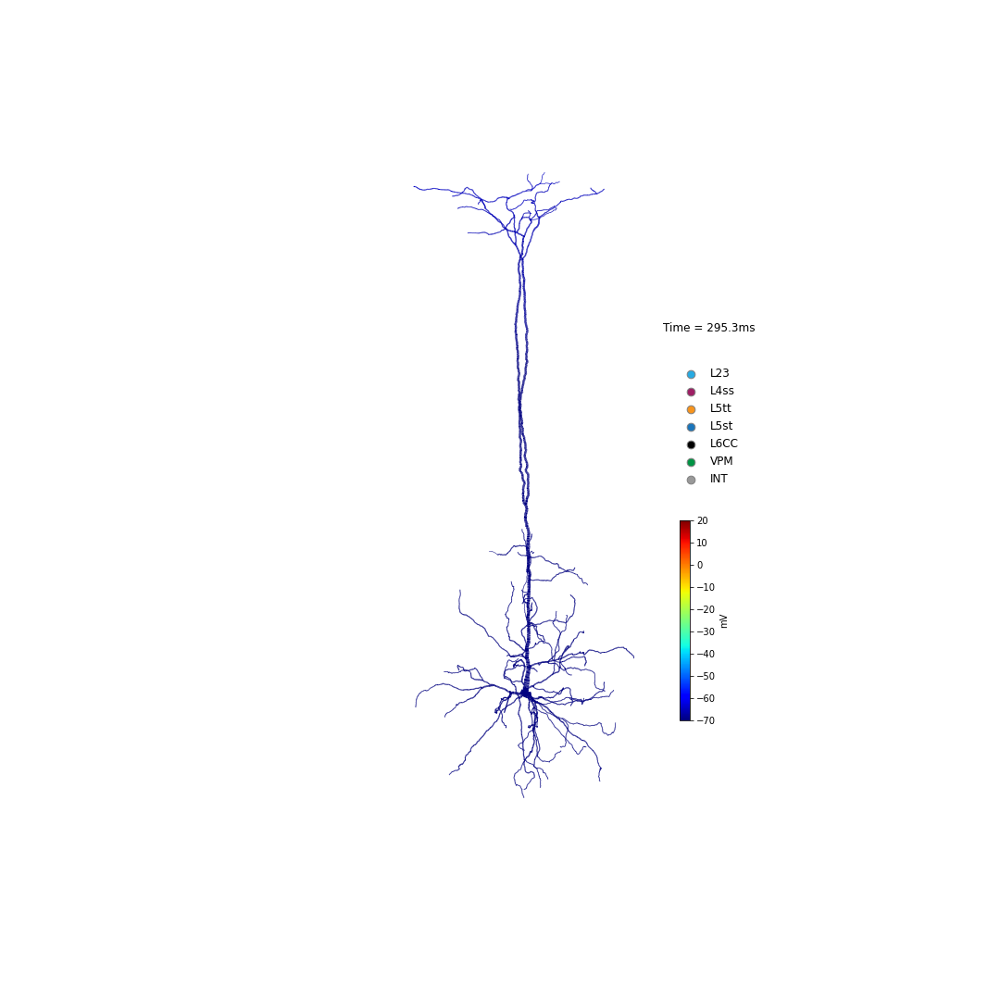
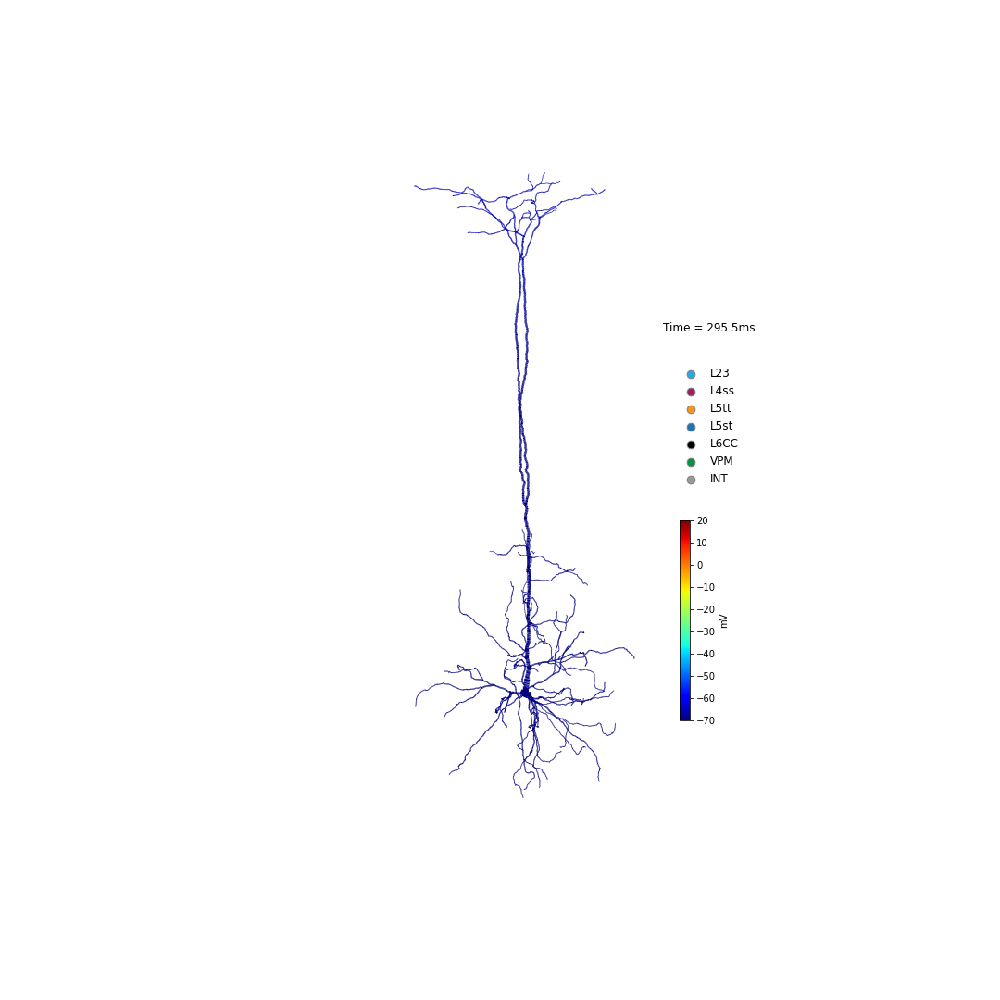
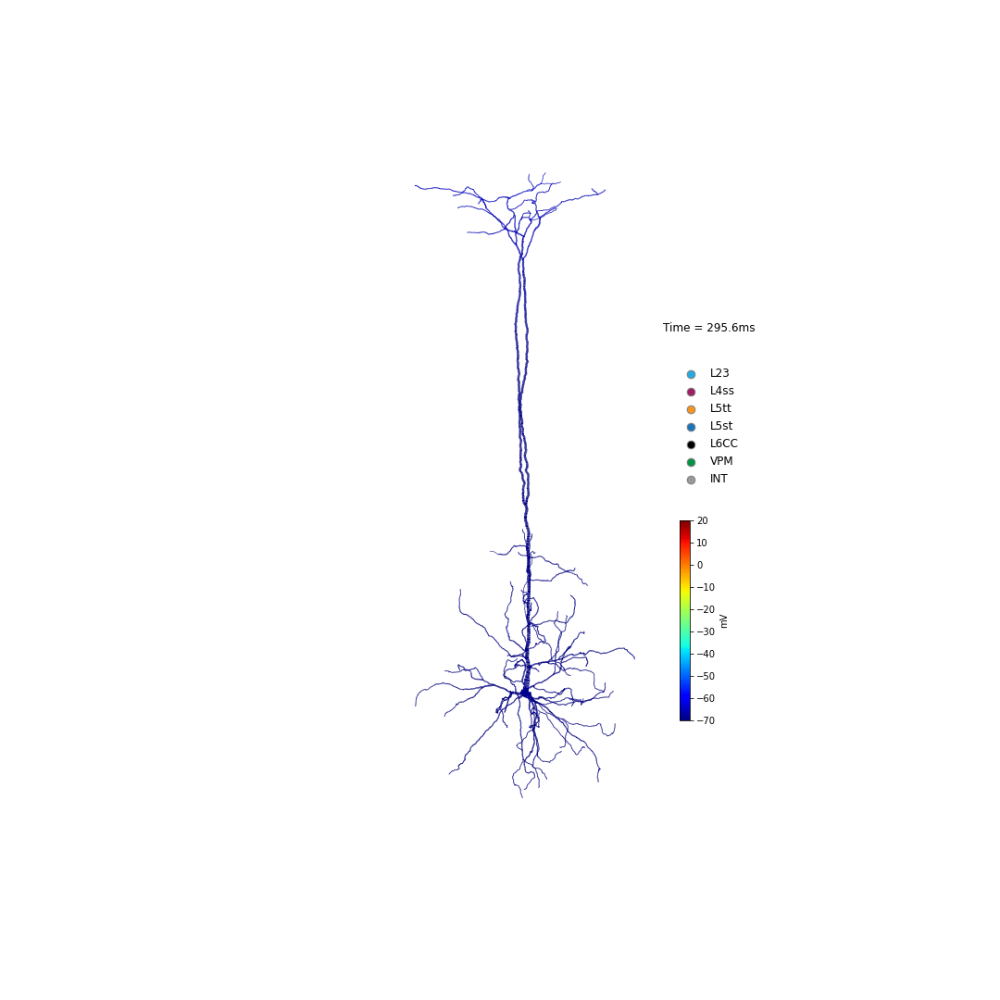
...
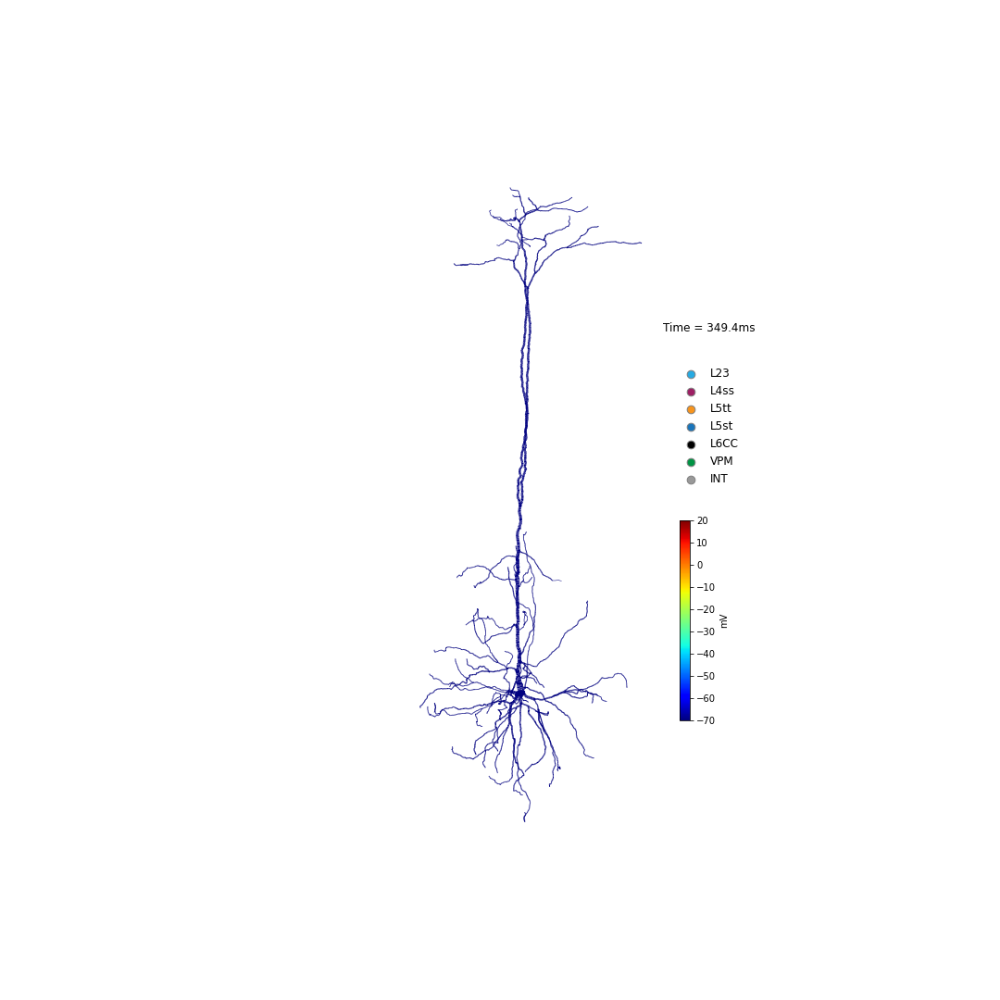
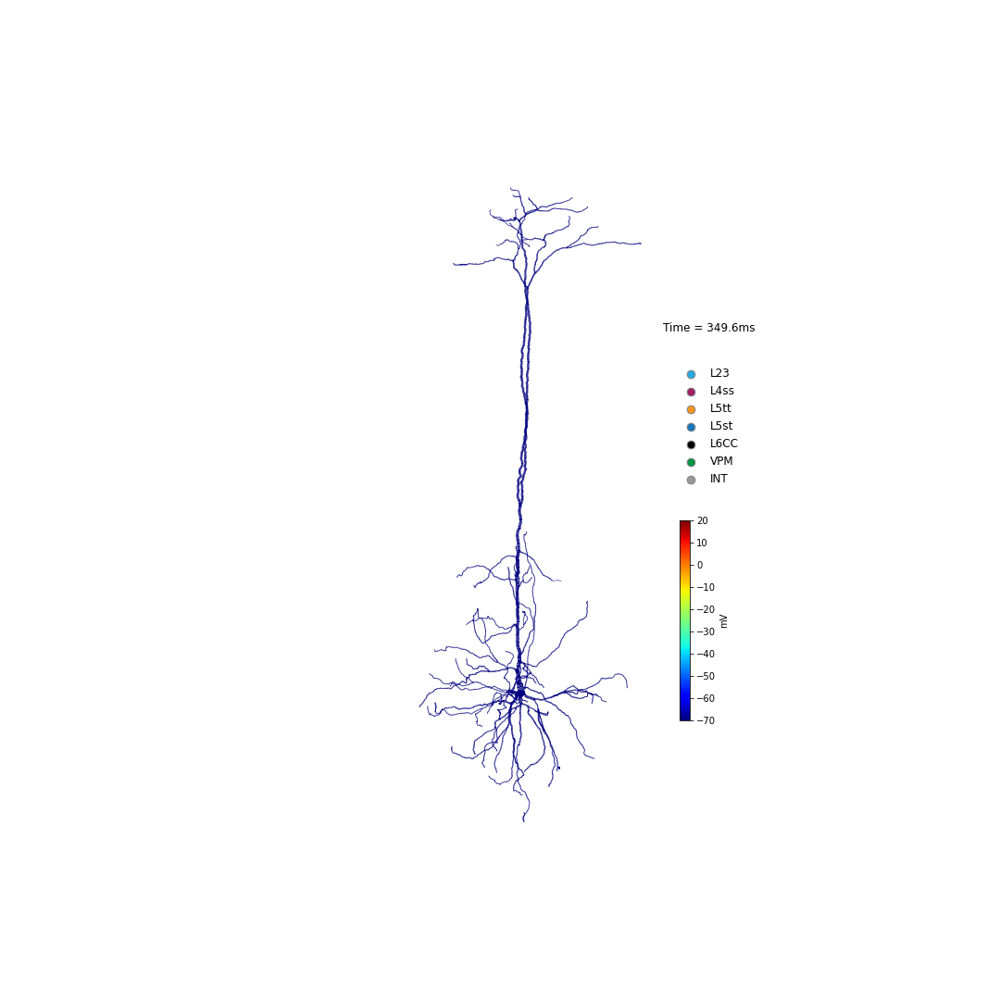
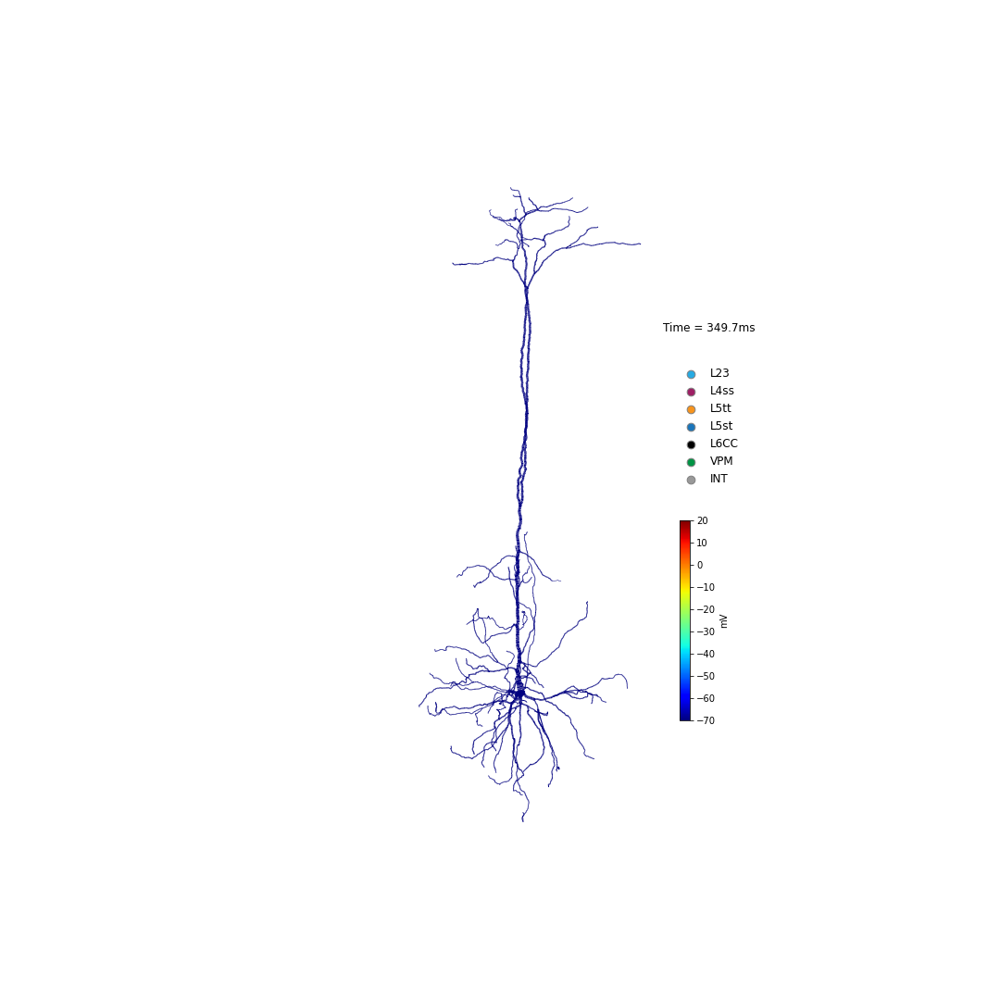
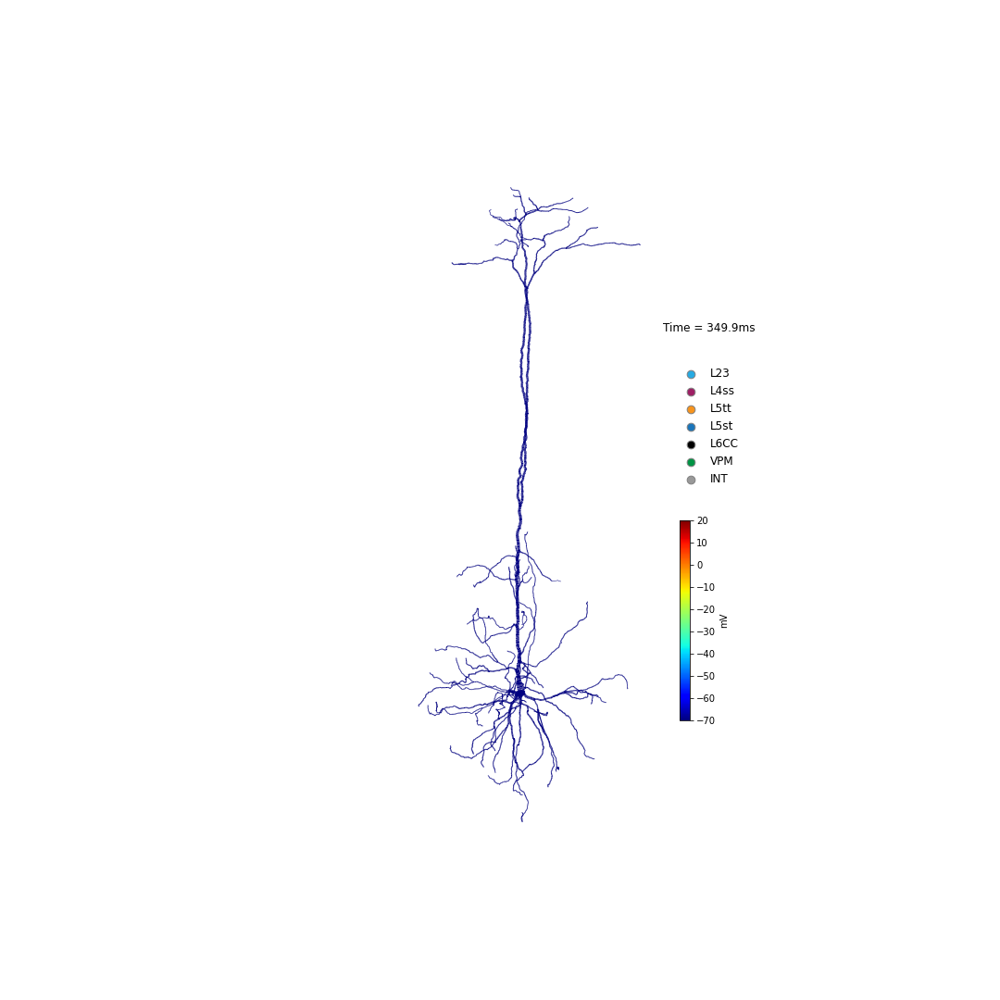
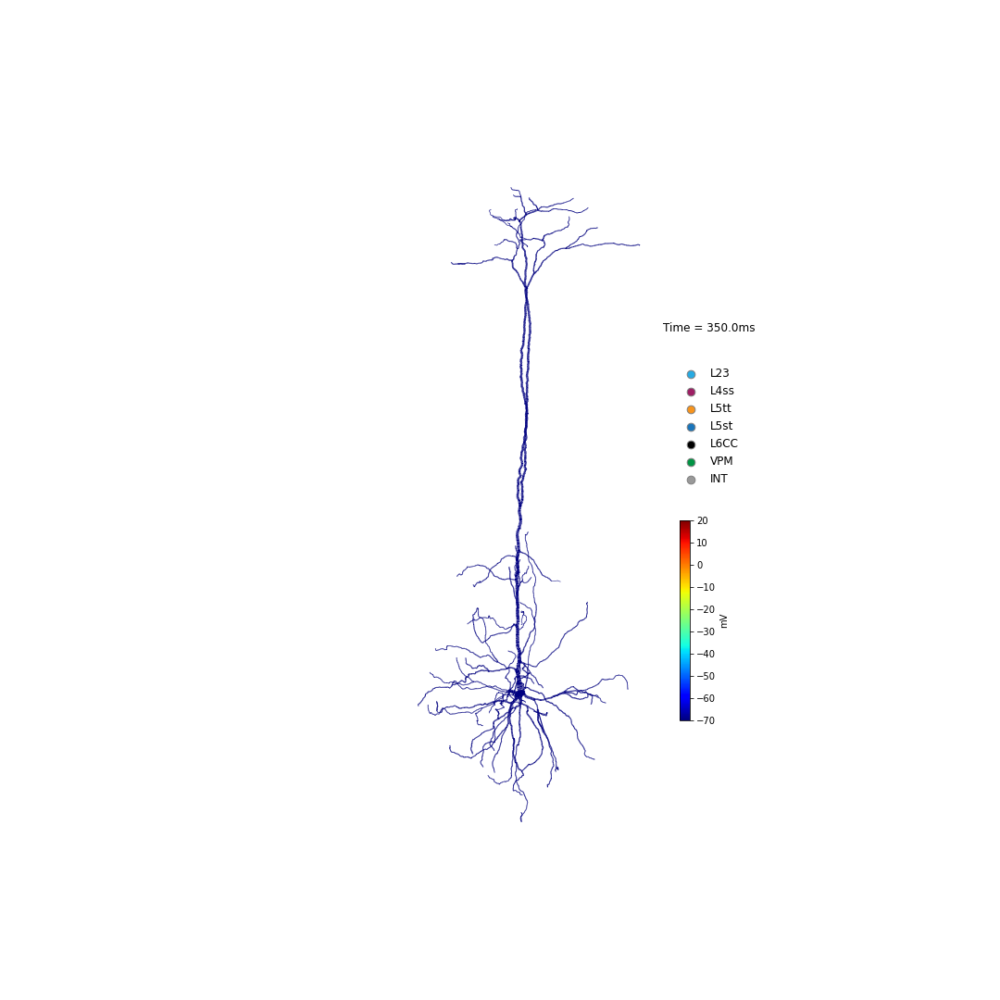

In [25]:
import visualize

# # Uncomment to re-create the video
# if I.os.path.exists(str(db.basedir/'visualize_morphology_3d')):
#     I.shutil.rmtree(str(db.basedir/'visualize_morphology_3d'))
output_folder = str(db.basedir/'visualize_morphology_3d')

cmv = visualize.CellMorphologyVisualizer(cell)
cmv.display_animation_voltage_synapses_in_morphology_3d(
    output_folder, client=I.get_client(), 
    t_start=295, t_end=350)

## Assessing the quality of biophysical parameters

In order to know if certain biophysical properties of a cell are realistic at all, they are clipped to in-vitro recorded values (or a generous interval, if they are poorly known), and benchmarked against in-vitro recorded cell responses. We use the same values as [Hay et al. \(2011\)](https://journals.plos.org/ploscompbiol/article?id=10.1371/journal.pcbi.1002107), but added the parameters:
- `scale_apical.scale`
- `SKv3.1 offset & slope`

[Hay et al. \(2011\)](https://journals.plos.org/ploscompbiol/article?id=10.1371/journal.pcbi.1002107) runs 5 stimulus protocols ($bAP$, $BAC$ and $3$ step currents) and compares the cell's response to a distribution of physiological parameters, the so-called **objectives** for [multi-objective optimization](../biophysics_fitting/MOEA_EH_minimal/), or [random-walk exploration](../biophysics_fitting/exploration_from_seedpoint/).

This is where the [Evaluator](../biophysics_fitting/evaluator.py) object comes in.

### Running all stimulus protocols

In [26]:
# may take a while, especially the step currents
voltage_traces = s.run(p)

Connection dropped: socket connection broken
Transition to CONNECTING
Session has expired
Connection dropped: socket connection broken
Transition to CONNECTING
Session has expired
Connection dropped: socket connection broken
Transition to CONNECTING
Session has expired
Connection dropped: outstanding heartbeat ping not received
Transition to CONNECTING


Connection dropped: socket connection broken
Transition to CONNECTING
Session has expired
Connection dropped: socket connection broken
Transition to CONNECTING
Session has expired
Connection dropped: socket connection broken
Transition to CONNECTING
Connection dropped: outstanding heartbeat ping not received
Transition to CONNECTING


`voltage_traces` is a dictionary with the voltage trace (i.e. NEURON's `tVec` and `vList`) of the cell for each stimulus protocol.

In [27]:
voltage_traces.keys()

dict_keys(['bAP.hay_measure', 'BAC.hay_measure', 'StepOne.hay_measure', 'StepTwo.hay_measure', 'StepThree.hay_measure'])

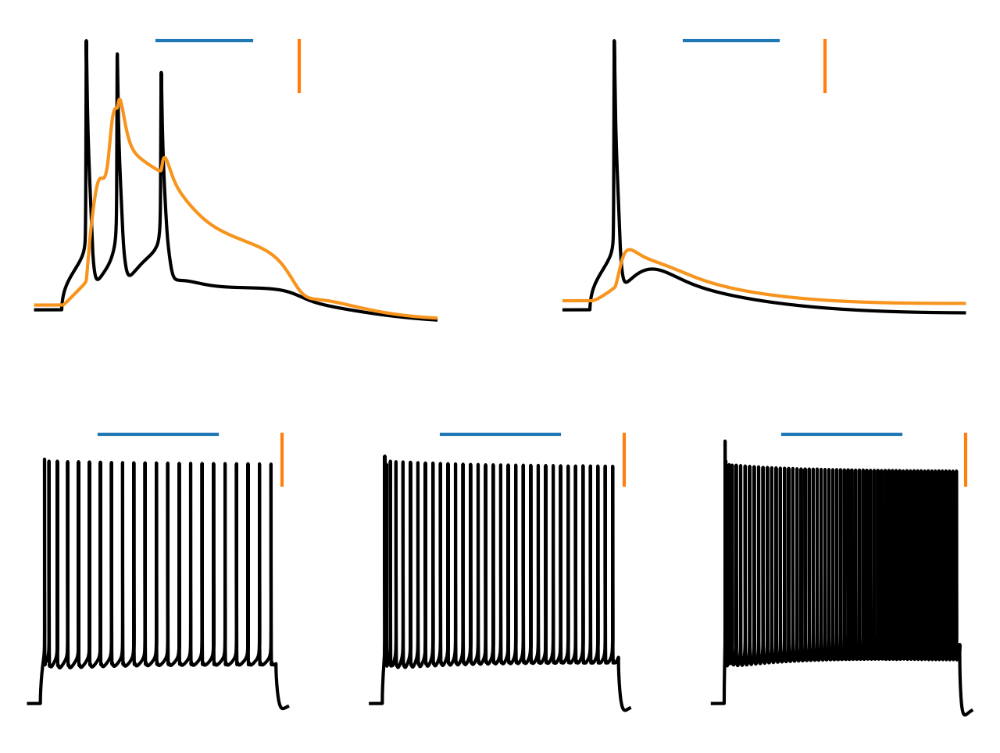

In [28]:
# visualize all responses
from visualize import voltage_trace_visualizer as vtv
vtv.visualize_vt(voltage_traces)

These responses *look* good, but looking is not a great quantifier. Let's see how far off these responses are compared to the in-vitro recorded ones

In [29]:
evaluation = e.evaluate(voltage_traces)

[WARNING] hay_evaluation: Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment) which has the purpose to 'just be there' such that the functionality necessary to evaluate voltage traces is available. This has the side effect that in the case of the variable time step solver, the timesteps can be changed.
[WARNING] hay_evaluation: Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment) which has the purpose to 'just be there' such that the functionality necessary to evaluate voltage traces is available. This has the side effect that in the case of the variable time step solver, the timesteps can be changed.
[WARNING] hay_evaluation: Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment)

`evaluation` contains a lot of information. Most are self-explanatory, but not all.

The original values for all objectives are saved under `.raw` variables. If multiple values exists for some objective, the mean is taken for further assessment. `.normalized` values are also available. If the variable does not end with `.normalized` or `.raw`, then it is in units of $\mu \pm \sigma$ compared to the in-vitro recorded physiological responses.

In [30]:
evaluation

{'1BAC_APheight.check_1AP': 'True',
 '1BAC_APheight.raw': array([30.03849529, 24.75845305, 17.36993834]),
 '1BAC_APheight.normalized': 0.8606735930617893,
 '1BAC_APheight': 0.8606735930617893,
 '1BAC_ISI.check_2_or_3_APs': 'True',
 '1BAC_ISI.check_repolarization': 'True',
 '1BAC_ISI.raw': 7.875,
 '1BAC_ISI.normalized': 2.3787718680286485,
 '1BAC_ISI': 2.3787718680286485,
 '1BAC_ahpdepth.check_2AP': 'True',
 '1BAC_ahpdepth.raw': array([-64.55325217, -62.93899138]),
 '1BAC_ahpdepth.normalized': 0.3134695566672727,
 '1BAC_ahpdepth': 0.3134695566672727,
 '1BAC_caSpike_height.check_1_Ca_AP': 'True',
 '1BAC_caSpike_height.check_>=2_Na_AP': 'True',
 '1BAC_caSpike_height.check_ca_max_after_nth_somatic_spike': 'True',
 '1BAC_caSpike_height.raw': 6.862455946898886,
 '1BAC_caSpike_height.normalized': 0.052148010590112495,
 '1BAC_caSpike_height': 0.052148010590112495,
 '1BAC_caSpike_width.check_1_Ca_AP': 'True',
 '1BAC_caSpike_width.raw': 38.825000000000045,
 '1BAC_caSpike_width.normalized': 1.098

In [36]:
filtered_evaluation = {k: v for k, v in evaluation.items() if \
    not k.endswith('.raw') and \
    not k.endswith('.normalized') and \
    not 'check' in k and \
    not k.endswith('err') and\
    not "1BAC" in k}
filtered_evaluation

{'2BAC_APheight': 1.0702484671457804,
 '2BAC_ISI': 0.44147000117411545,
 '2BAC_ahpdepth': 0.35424745806604463,
 '2BAC_caSpike_height': 0.26772111685278294,
 '2BAC_caSpike_width': 1.185039370078731,
 '2BAC_spikecount': 0.0,
 'bAP_APheight': 1.0076846781448126,
 'bAP_APwidth': 2.1000000000000227,
 'bAP_att2': 1.2949374621278273,
 'bAP_att3': 1.6864762952345045,
 'bAP_spikecount': 0.0,
 'mf1': 2.272727272727273,
 'AI1': 0.5483077417136597,
 'ISIcv1': 1.7226162728594847,
 'DI1': 0.5884109916367961,
 'TTFS1': 1.0792349726775925,
 'APh1': 1.5071587724227082,
 'fAHPd1': 1.5917723280400997,
 'sAHPd1': 0.80106601417295,
 'sAHPt1': 0.24620347020550856,
 'APw1': 2.366748566748531,
 'mf2': 3.571428571428571,
 'AI2': 1.3927309146286722,
 'ISIcv2': 0.33206310625141927,
 'DI2': 0.7890173410404545,
 'TTFS2': 0.2599179206566472,
 'APh2': 0.2628773527281259,
 'fAHPd2': 1.16421730675727,
 'sAHPd2': 0.1261248282839032,
 'sAHPt2': 1.2082080631180157,
 'APw2': 1.6493354224623822,
 'mf3': 4.050040500405004,


In [43]:
def translate_objective(objective):
    step_map = {
        'mf': "Spike frequency",
        'AI': 'Adaptation Index',
        'ISIcv': "Interspike Interval \n Coefficient of Variation",
        'DI': "Initial burst ISI",
        'TTFS': "First spike latency",
        'APh': "AP peak",
        'fAHPd': "Fast AHP Depth",
        'sAHPd': "Slow AHP Depth",
        'sAHPt': "Slow AHP Time",
        'APw': "AP half-width",
    }
    if not "bAP" in objective and not "BAC" in objective:
        # must be step current objective
        t, i = objective[:-1], objective[-1]
        t = step_map[t]
    else:
        t = objective
    return t

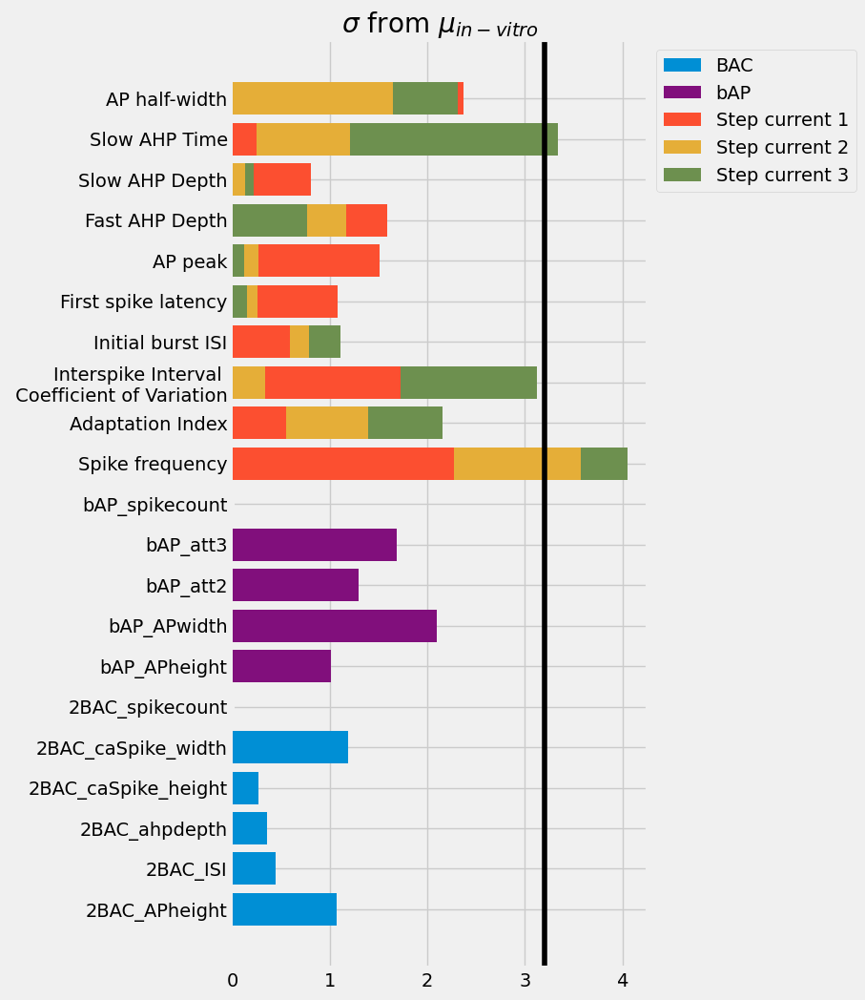

In [66]:
%matplotlib inline
from collections import OrderedDict
colors = I.plt.rcParams['axes.prop_cycle'].by_key()['color']

fig = I.plt.figure(figsize=(5, 12))
ax = fig.gca()
I.plt.style.use("fivethirtyeight")
for k, v in filtered_evaluation.items():
    if "BAC" in k:
        label="BAC"
        c = colors[0]
    elif 'bAP' in k:
        label = "bAP"
        c = colors[5]
    else:
        label = "Step current {}".format(k[-1])
        c = colors[int(k[-1])]
    ax.barh(y=translate_objective(k), width=v, zorder=5-v, label=label, color=c)
handles, labels = I.plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))
I.plt.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1, 1))
I.plt.title("$\sigma$ from $\mu_{in-vitro}$")
I.plt.axvline(3.2, c='k')
I.plt.show()

We see that only the spike frequency of step current $2$ and $3$, as well as Slow AHP Time of step current $3$ cross the $3.2 \sigma$ mark. Not bad, when you keep in mind that we have constrained for over $40$ objectives at once

## record apical conductance and make current contribution plot

In [ ]:
# from project_specific_ipynb_code.biophysical_models import modify_simulator_to_record_apical_dendrite_conductances

In [ ]:
rangeVarsApical = project_specific_ipynb_code.biophysical_models.rangeVarsApical

In [ ]:
rangeVarsApical

In [ ]:
for rv in rangeVarsApical:
    cell.record_range_var(rv)

In [ ]:
I.scp.init_neuron_run(sim_params, vardt = True)

In [ ]:
colormap = {'Ca_HVA.ica': '#4682C3',
 'Ca_LVAst.ica': '#ACD7E4',
 'Ih.ihcn': '#838383',
 'Im.ik': '#F2E500',
 'NaTa_t.ina': '#EE781C',
 'SK_E2.ik': '#06652E',
 'SKv3_1.ik': '#9BC985'}

In [ ]:
ca = project_specific_ipynb_code.biophysical_models.CurrentAnalysis(cell, colormap=colormap, rangeVars = rangeVarsApical)
ca.plot_areas(plot_voltage = True, t_stim=295, select_window_relative_to_stim=(0,700))